In [1]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from distutils.version import StrictVersion
from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops

if StrictVersion(tf.__version__) < StrictVersion('1.9.0'):
  raise ImportError('Please upgrade your TensorFlow installation to v1.9.* or later!')

/home/felicia/anaconda2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/felicia/anaconda2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/felicia/anaconda2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/felicia/anaconda2/lib/python3.6/site-packages/tensorflow/python/framework

In [ ]:
# This is needed to display the images.
%matplotlib inline

In [2]:
from utils import label_map_util
from utils import visualization_utils as vis_util

/home/felicia/anaconda2/lib/python3.6/site-packages/matplotlib/__init__.py:1405: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


In [3]:
# What model to download.
MODEL_NAME = 'ssd_inception_v2_coco_2018_01_28'

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_FROZEN_GRAPH = 'pretrained/'+ MODEL_NAME + '/frozen_inference_graph.pb'

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = os.path.join('data', 'mscoco_label_map.pbtxt')

In [4]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_FROZEN_GRAPH, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

In [5]:
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [ ]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [6]:
PATH_TO_TEST_IMAGES_DIR = '/media/felicia/Data/mlb-youtube/frames_continuous/swing'
# TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_TEST_IMAGES_DIR, '377H4PC2NSEP{:04d}.jpg'.format(i)) for i in range(120, 140) ]
image_batch=list() 
HEIGHT=720
WIDTH=1280
for file in os.listdir(PATH_TO_TEST_IMAGES_DIR)[:50]:
    image=Image.open(os.path.join(PATH_TO_TEST_IMAGES_DIR,file))
    image_np=np.asarray(image).reshape(HEIGHT, WIDTH,3).astype(np.uint8)
    image_batch.append(np.expand_dims(image_np,0))
image_batch=np.concatenate(image_batch,axis=0) # B*H*W*C
# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

In [7]:
WIDTH=1280
print(image_batch.shape)

(50, 720, 1280, 3)


In [8]:
from tqdm import tqdm
import time
import cv2

mask = np.zeros(image_batch.shape[1:3],np.uint8)
bgdModel = np.zeros((1,65),np.float64)
fgdModel = np.zeros((1,65),np.float64)
rect = (0,10,WIDTH,HEIGHT) # rect = (start_x, start_y, width, height): (161,79,WIDTH,HEIGHT)

image_foreground=list()
gray_foreground=list()

start_time=time.time()

for i in tqdm(range(image_batch.shape[0])): #B*H*W*C
    cv2.grabCut(image_batch[i],mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
    mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')
    img_ = image_batch[i]*mask2[:,:,np.newaxis]
    image_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
    image_foreground.append(np.expand_dims(img_,axis=0))
    gray_foreground.append(np.expand_dims(image_gray,axis=0))
# print(gray.shape)
elapsed_time = time.time() - start_time

image_foreground=np.concatenate(image_foreground,axis=0) # B*H*W *3
gray_foreground=np.concatenate(gray_foreground,axis=0) # B*H*W

print(image_foreground.shape)
print(elapsed_time)

100%|██████████| 50/50 [05:16<00:00,  6.16s/it]

(50, 720, 1280, 3)
316.73857617378235


In [ ]:
def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session() as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {output.name for op in ops for output in op.outputs}
#             print(all_tensor_names)
            tensor_dict = {}
            for key in [
              'num_detections', 'detection_boxes', 'detection_scores',
              'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                 feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
              'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict

In [9]:
def run_inference_for_minibatch_images(images, graph):
    """
    images: numpy.array- B*H *W *C
    """
    with graph.as_default():
        with tf.Session() as sess:
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
              'num_detections', 'detection_boxes', 'detection_scores',
              'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(tensor_name)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                 feed_dict={image_tensor: images})
            
            # all outputs are float32 numpy arrays, so convert types as appropriate
#             output_dict['num_detections'] = int(output_dict['num_detections'][0])
#             output_dict['detection_classes'] = output_dict[
#               'detection_classes'][0].astype(np.uint8)
#             output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
#             output_dict['detection_scores'] = output_dict['detection_scores'][0]
#             if 'detection_masks' in output_dict:
#                 output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict

In [ ]:
def valid_boxes_on_single_image(image,boxes,classes,scores,max_boxes_to_draw,min_score_thresh):
    valid_output={}
    valid_boxes=[]
    valid_scores=[]
#     valid_classes=[]
    im_height = image.shape[0]
    im_width=image.shape[1]
    for i in range(min(max_boxes_to_draw,boxes.shape[0])):
        if scores[i]> min_score_thresh and classes[i]==1:
            ymin, xmin, ymax, xmax=boxes[i]
            (left, right, top, bottom) = (xmin * im_width, xmax * im_width, ymin * im_height, ymax * im_height)
            valid_boxes.append([left, right, top, bottom])
            valid_scores.append(scores[i])
#     valid_boxes=np.array(valid_boxes)
#     valid_scores=np.array(valid_scores)
    valid_output['boxes']=valid_boxes
    valid_output['scores']=valid_scores
    return valid_output
            

In [10]:
image_row=np.array([[r for c in range(WIDTH)] for r in range(HEIGHT)]) # H*W
image_col=np.array([[c for c in range(WIDTH)] for r in range(HEIGHT)])


def foreground_mask_image_array(boxes,scores,max_boxes_to_draw=5,alpha=0.2):
    valid_output={}
    valid_boxes=[]
    valid_scores=[]
    
    batchsize=boxes.shape[0]
    nboxes=boxes.shape[1]
    batch_row=np.array([[image_row for i in range(nboxes)] for j in range(batchsize)])
    batch_col=np.array([[image_col for i in range(nboxes)] for j in range(batchsize)])

    # (left, right, top, bottom) = (xmin * WIDTH, xmax * WIDTH, ymin * HEIGHT, ymax * HEIGHT)
    normalized_h=boxes[:,:,2]-boxes[:,:,0]  #  B*4:ymax-ymin
    normalized_w=boxes[:,:,3]-boxes[:,:,1]  #  B*4:xmax-xmin
    areas=np.multiply(normalized_w,normalized_h)
    
    boxes_xmin=boxes[:,:,1] # B*nboxes
    boxes_xmin=np.tile(boxes_xmin[:,:,np.newaxis,np.newaxis],(1,1,HEIGHT,WIDTH))
    boxes_xmax=boxes[:,:,3]
    boxes_xmax=np.tile(boxes_xmax[:,:,np.newaxis,np.newaxis],(1,1,HEIGHT,WIDTH))
    boxes_ymin=boxes[:,:,0]
    boxes_ymin=np.tile(boxes_ymin[:,:,np.newaxis,np.newaxis],(1,1,HEIGHT,WIDTH))
    boxes_ymax=boxes[:,:,2]
    boxes_ymax=np.tile(boxes_ymax[:,:,np.newaxis,np.newaxis],(1,1,HEIGHT,WIDTH))

    row_mask=np.greater_equal(batch_row,HEIGHT*boxes_ymin) & np.less_equal(batch_row,HEIGHT*boxes_ymax)
    col_mask=np.greater_equal(batch_col,WIDTH*boxes_xmin) & np.less_equal(batch_row,WIDTH*boxes_xmax)
    box_mask=row_mask& col_mask # B*10 *H*W
    gray_foregrounds=np.repeat(gray_foreground[:,np.newaxis,:,:],10,axis=1) # B*100*H*W
    foreground_region=np.sum(np.multiply(gray_foregrounds,box_mask),axis=(2,3)) # B* 100 
    foreground_mask=(np.divide(foreground_region,HEIGHT*WIDTH*areas)>255*alpha).astype('uint8')  # B* 100 
    
    for i in tqdm(range(batchsize)):
        valid_box=boxes[i][foreground_mask[i]==1][:max_boxes_to_draw,:]
        valid_score=scores[i][foreground_mask[i]==1][:max_boxes_to_draw]
        if valid_box.shape[0]<max_boxes_to_draw:
            valid_box=np.pad(valid_box,((0,max_boxes_to_draw-valid_box.shape[0]),(0,0)),'constant',constant_values=((0,0),(0,0)))
            valid_score=np.pad(valid_score,(0,max_boxes_to_draw-valid_score.shape[0]),'constant',constant_values=(0,0))
        valid_boxes.append(valid_box)
        valid_scores.append(valid_score)
    valid_output['boxes']=np.array(valid_boxes)
    valid_output['scores']=np.array(valid_scores)
    
    return valid_output

In [11]:
def valid_boxes_on_minibatch_images(image,boxes,classes,scores,max_boxes_to_draw,min_score_thresh,min_area,max_area):
    """
    boxes: B*100 *4
    classes: B*100
    scores: B*100 --> B*4
    """
    valid_output={}
    valid_boxes=[]
    valid_scores=[]
    b=boxes.shape[0]
    class_mask=(classes==1).astype(np.int)
    score_mask=(scores>min_score_thresh).astype(np.int)
    
    normalized_h=boxes[:,:,2]-boxes[:,:,0]  #  B*4:ymax-ymin
    normalized_w=boxes[:,:,3]-boxes[:,:,1]  #  B*4:xmax-xmin
    normalized_area=np.multiply(normalized_w,normalized_h)
    area_mask=((normalized_area<max_area) & (normalized_area> min_area)).astype(np.int) 
    
    valid_mask=class_mask & score_mask & area_mask  # B *100
    
    for i in tqdm(range(b)):
        valid_box=boxes[i][valid_mask[i]==1][:max_boxes_to_draw,:]
        valid_score=scores[i][valid_mask[i]==1][:max_boxes_to_draw]
        if valid_box.shape[0]<max_boxes_to_draw:
            valid_box=np.pad(valid_box,((0,max_boxes_to_draw-valid_box.shape[0]),(0,0)),'constant',constant_values=((0,0),(0,0)))
            valid_score=np.pad(valid_score,(0,max_boxes_to_draw-valid_score.shape[0]),'constant',constant_values=(0,0))
        valid_boxes.append(valid_box)
        valid_scores.append(valid_score)
    valid_output['boxes']=np.array(valid_boxes)
    valid_output['scores']=np.array(valid_scores)
    return valid_output

In [ ]:
# b=[[1,2],[2.3]]
score_mask=(output_dict['detection_scores']>0).astype(np.int)
class_mask=(output_dict['detection_classes']==1).astype(np.int)
mask=score_mask &  class_mask
boxes=output_dict['detection_boxes']
scores=output_dict['detection_scores']
temp=scores[6][mask[3]==1][:4]
print(temp)
temp=np.pad(temp,(0,4-temp.shape[0]),'constant',constant_values=(0,0))
print(temp.shape)
# ----------------------------------------
normalized_boxes=valid_output['boxes'] #B*4* 4: ymin, xmin, ymax, xmax 
# (left, right, top, bottom) = (xmin * WIDTH, xmax * WIDTH, ymin * HEIGHT, ymax * HEIGHT)
normalized_h=normalized_boxes[:,:,2]-normalized_boxes[:,:,0]  #  B*4:ymax-ymin
normalized_w=normalized_boxes[:,:,3]-normalized_boxes[:,:,1]  #  B*4:xmax-xmin
normalized_area=np.multiply(normalized_w,normalized_h)
# print(normalized_h[-1])
# print(normalized_w[-1])
print(normalized_area.shape) # B*max_box
# min_area: 0.02(0.01)  max_area: 0.15

In [17]:
max_boxes=10
min_score=0
min_area= 0.015 #0.01, 0.02 
max_area= 0.15

output_dict = run_inference_for_minibatch_images(image_batch, detection_graph)

valid_output=valid_boxes_on_minibatch_images(
    image_batch,
    output_dict['detection_boxes'],
    output_dict['detection_classes'],
    output_dict['detection_scores'],
    max_boxes,
    min_score,
    min_area,
    max_area)
valid_output=foreground_mask_image_array(valid_output['boxes'],valid_output['scores'],max_boxes_to_draw=10,alpha=0.15)
# valid_output['boxes'].shape
# valid_output['scores'].shape

100%|██████████| 50/50 [00:00<00:00, 9314.88it/s]
/home/felicia/anaconda2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in true_divide
/home/felicia/anaconda2/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in greater
100%|██████████| 50/50 [00:00<00:00, 1700.91it/s]


In [13]:
valid_output['boxes'].shape

(50, 10, 4)

In [ ]:
import cv2

PATH_TO_TEST_IMAGES_DIR = '/media/felicia/Data/mlb-youtube/frames_continuous/swing'

# TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_TEST_IMAGES_DIR, '0N3KQ6UR9DX8{:04d}.jpg'.format(i)) for i in range(19) ]
# image_depth=list() 
# HEIGHT=720
# WIDTH=1280
# for filename in TEST_IMAGE_PATHS:
#     image=Image.open(filename)
#     image_np=np.asarray(image).reshape(HEIGHT, WIDTH,3).astype(np.uint8)
#     image_depth.append(np.expand_dims(image_np,0))
# image_depth=np.concatenate(image_depth,axis=0) # B*H*W*C

# Size, in inches, of the output images.

# imgL = cv2.imread(os.path.join(PATH_TO_TEST_IMAGES_DIR,'0N3KQ6UR9DX80000.jpg'),0)
# imgR = cv2.imread(os.path.join(PATH_TO_TEST_IMAGES_DIR,'0N3KQ6UR9DX80005.jpg'),0)
# print(np.array(imgL).shape)
# stereo = cv2.StereoBM_create(numDisparities=16, blockSize=75) # numDisparities=16, blocksize=15
# disparity = stereo.compute(imgL,imgR)
# plt.imshow(disparity,'gray')
# plt.show()

# -------------------------------------
img = cv2.imread(os.path.join(PATH_TO_TEST_IMAGES_DIR,'0PL0K86E2C550015.jpg')) # 0N3KQ6UR9DX8

mask = np.zeros(img.shape[:2],np.uint8)

bgdModel = np.zeros((1,65),np.float64)
fgdModel = np.zeros((1,65),np.float64)

rect = (0,10,WIDTH,HEIGHT) # rect = (start_x, start_y, width, height): (161,79,WIDTH,HEIGHT)

cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')
img_ = img*mask2[:,:,np.newaxis]
foreground_mask=(img_>0).astype('uint8')
# print(img.shape,foreground_mask)
img = img*foreground_mask
plt.imshow(img)
plt.colorbar()
plt.show()

In [ ]:
image_row=np.array([[r for c in range(WIDTH)] for r in range(HEIGHT)]) # H*W
image_col=np.array([[c for c in range(WIDTH)] for r in range(HEIGHT)])
# print(image_row[0],image_col[0])
batch_row=np.array([[image_row for i in range(10)] for j in range(10)])
batch_col=np.array([[image_col for i in range(10)] for j in range(10)])

normalized_boxes=valid_output['boxes'] #B*10* 4: ymin, xmin, ymax, xmax 
# (left, right, top, bottom) = (xmin * WIDTH, xmax * WIDTH, ymin * HEIGHT, ymax * HEIGHT)
normalized_h=normalized_boxes[:,:,2]-normalized_boxes[:,:,0]  #  B*4:ymax-ymin
normalized_w=normalized_boxes[:,:,3]-normalized_boxes[:,:,1]  #  B*4:xmax-xmin
normalized_area=np.multiply(normalized_w,normalized_h) # B* 100 
normalized_xmin=normalized_boxes[:,:,1] #B*10
normalized_xmin=np.tile(normalized_xmin[:,:,np.newaxis,np.newaxis],(1,1,HEIGHT,WIDTH))
normalized_xmax=normalized_boxes[:,:,3]
normalized_xmax=np.tile(normalized_xmax[:,:,np.newaxis,np.newaxis],(1,1,HEIGHT,WIDTH))
normalized_ymin=normalized_boxes[:,:,0]
normalized_ymin=np.tile(normalized_ymin[:,:,np.newaxis,np.newaxis],(1,1,HEIGHT,WIDTH))
# print(normalized_ymin.shape)
normalized_ymax=normalized_boxes[:,:,2]
normalized_ymax=np.tile(normalized_ymax[:,:,np.newaxis,np.newaxis],(1,1,HEIGHT,WIDTH))

row_mask=np.greater_equal(batch_row,HEIGHT*normalized_ymin) & np.less_equal(batch_row,HEIGHT*normalized_ymax)
col_mask=np.greater_equal(batch_col,WIDTH*normalized_xmin) & np.less_equal(batch_row,WIDTH*normalized_xmax)
box_mask=row_mask& col_mask # B*10 *H*W
# foreground_region=np.sum(image_foreground& box_mask,axis=(0,1))
# print(foreground_region.shape)
# print(gray_foreground.shape)
gray_foregrounds=np.repeat(gray_foreground[:,np.newaxis,:,:],10,axis=1) # B*100*H*W
foreground_region=np.sum(np.multiply(gray_foregrounds,box_mask),axis=(2,3)) # B* 100 
foreground_mask=(np.divide(foreground_region,HEIGHT*WIDTH*normalized_area)>255*0.2).astype('uint8')  # B* 100 
print(foreground_region)

In [ ]:
print(foreground_mask)

In [ ]:
# box_mask_ymin=np.greater_equal(batch_row,HEIGHT*normalized_ymin) #2,1
# box_mask_ymax=np.less_equal(batch_row,HEIGHT*normalized_ymax)
box_mask=(np.greater_equal(batch_row,HEIGHT*normalized_ymin) & np.less_equal(batch_row,HEIGHT*normalized_ymax)).astype('uint8')
for i in range(50):
    for j in range(10):
        print(i,j,HEIGHT*normalized_boxes[i,j])
        print(box_mask[i,j])
# print(box_mask_ymin[2,1])
# print(normalized_boxes[2,1,:]*HEIGHT)
# print(box_mask_ymin[2,1,142:412])
# print( box_mask_ymax[2,1,142:412])
# print((box_mask_ymin[2,1,142:412] &box_mask_ymax[2,1,142:412]).astype('uint8'))
# print(box_mask[2,1,142:412])

0 Area [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0 Accuracy [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
1 Area [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
1 Accuracy [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
2 Area [0.0490572  0.03028619 0.         0.         0.         0.
 0.         0.         0.         0.        ]
2 Accuracy [0.57391983 0.57289886 0.         0.         0.         0.
 0.         0.         0.         0.        ]
3 Area [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
3 Accuracy [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
4 Area [0.02365764 0.03714044 0.03050166 0.02103439 0.         0.
 0.         0.         0.         0.        ]
4 Accuracy [0.67850924 0.6266997  0.5021898  0.3151484  0.         0.
 0.         0.         0.         0.        ]
5 Area [0.02419805 0.04704524 0.         0.         0.         0.
 0.         0.         0.         0.        ]
5 Accuracy [0.8749999  0.67862356 0.         0.         0.         0.
 0.         0.         0.         0.        ]
6 Area [0.06463546 0.         0.         0.         0.         0.
 0. 

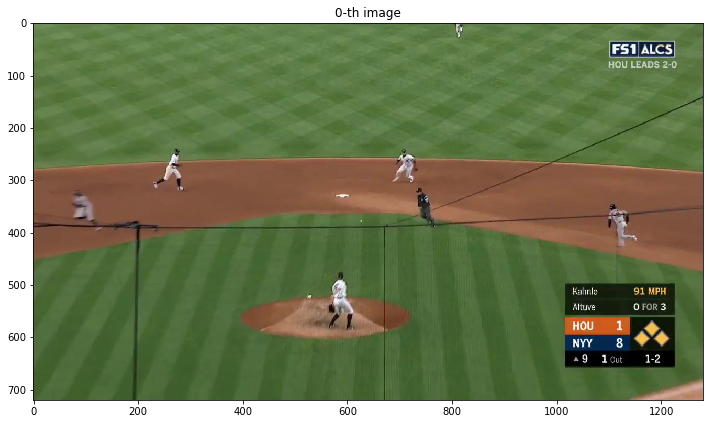

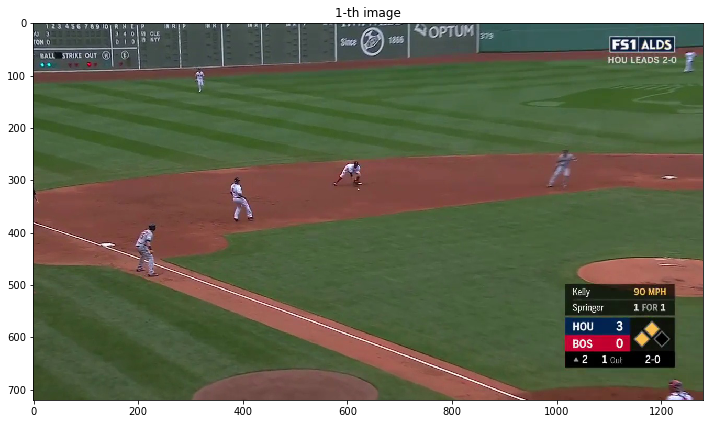

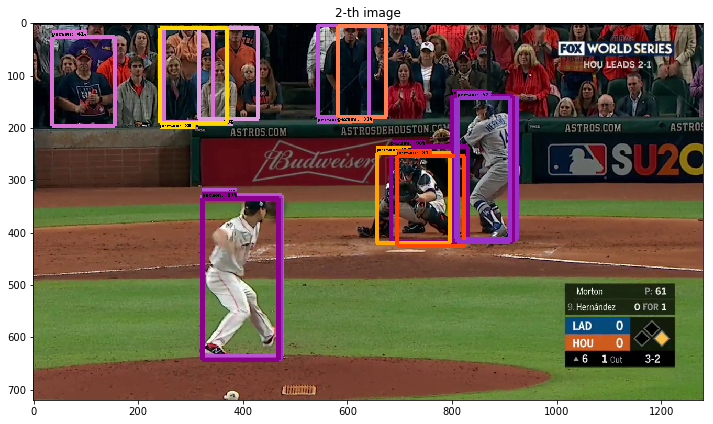

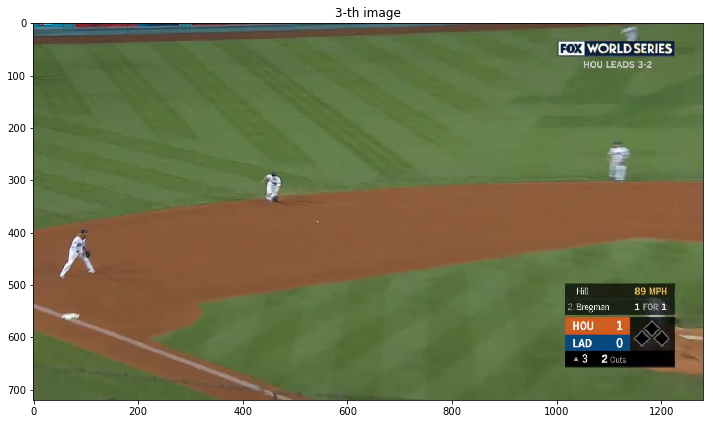

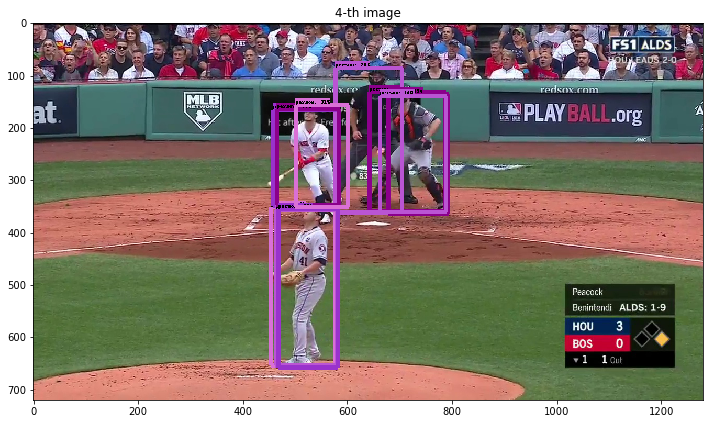

...

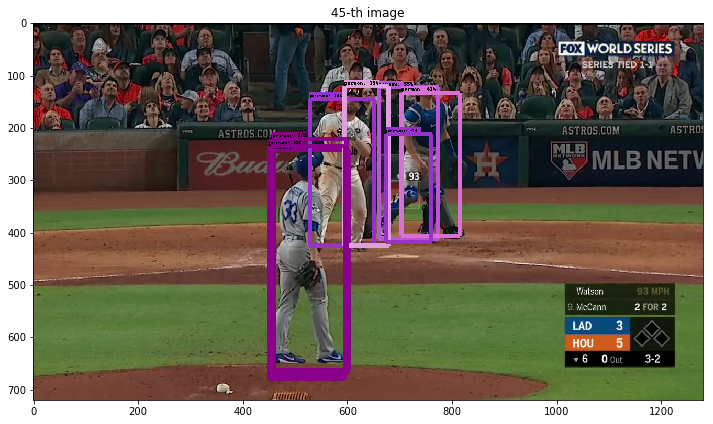

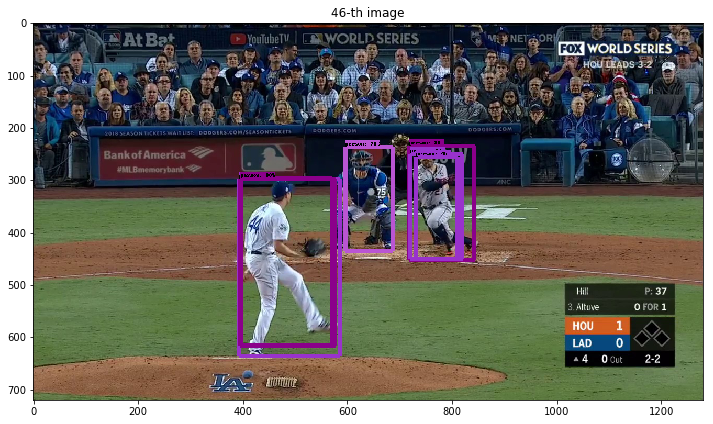

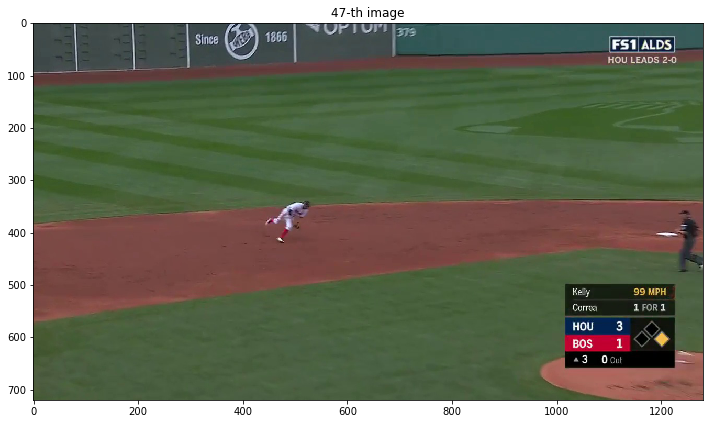

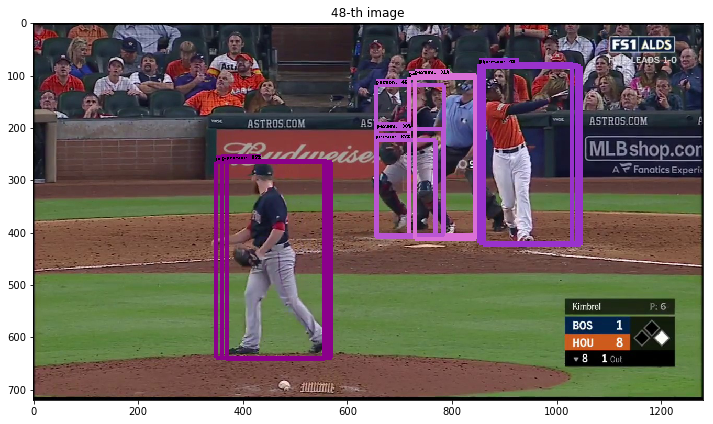

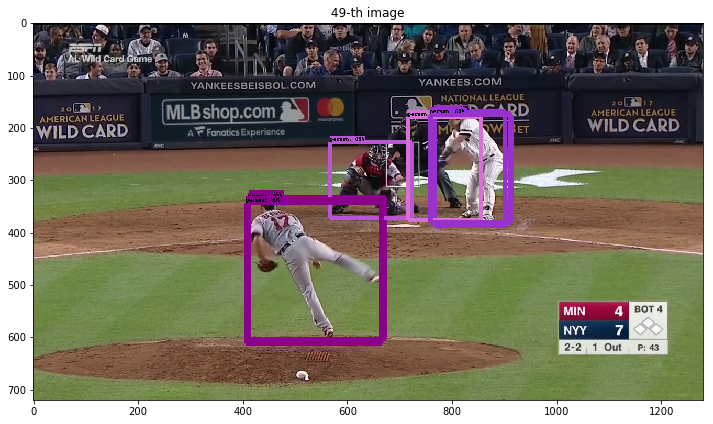

In [18]:
# import time
valid_output['classes']=np.ones((image_batch.shape[0],max_boxes)).astype(np.int)
normalized_boxes=valid_output['boxes'] #B*4* 4: ymin, xmin, ymax, xmax 
normalized_h=normalized_boxes[:,:,2]-normalized_boxes[:,:,0]  #  B*4:ymax-ymin
normalized_w=normalized_boxes[:,:,3]-normalized_boxes[:,:,1]  #  B*4:xmax-xmin
normalized_area=np.multiply(normalized_w,normalized_h)

for i in range(image_batch.shape[0]):
    vis_util.visualize_ordered_boxes_and_labels_on_image_array(
        image_batch[i],
        valid_output['boxes'][i], # 4 * 4, ymin, xmin, ymax, xmax = box
        valid_output['classes'][i], # (4,)
        valid_output['scores'][i], # (4,)
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=max_boxes,
        min_score_thresh=min_score,
        line_thickness=8)
#     box_h=valid_output['boxes'][i][:,2]-valid_output['boxes'][i][:,0]
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_batch[i])
    plt.title('%d-th image'%i)
    # (left, right, top, bottom) = (xmin * WIDTH, xmax * WIDTH, ymin * HEIGHT, ymax * HEIGHT)
    print(i,'Area',normalized_area[i])
    print(i,'Accuracy', valid_output['scores'][i])


In [ ]:
max_boxes=4
min_score=.5

for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image) # H * W * C
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'], # N * 4
        output_dict['detection_classes'], # starts at 1
        output_dict['detection_scores'], # ymin, xmin, ymax, xmax = box
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        use_normalized_coordinates=True,
        max_boxes_to_draw=max_boxes,
        min_score_thresh=min_score,
        line_thickness=8)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)

    valid_output=valid_boxes_on_single_image(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        max_boxes,
        min_score)
    print(valid_output)
    

In [ ]:
image_height=image_np.shape[0] # H * W * C
image_width=image_np.shape[1]
boxes=output_dict['detection_boxes'] # 100 *4
scores=output_dict['detection_scores'] # 100
classes=output_dict['detection_classes']
max_boxes_to_draw=5
min_score_thresh=.5

print(type(classes))